The Python time module provides many ways of representing time in code, such as (named) tuples, numbers, and strings. It also provides functionality other than representing time, like waiting during code execution and measuring the efficiency of your code.

By the end of this article, you’ll be able to:

    1) Understand core concepts at the heart of working with dates and times, such as epochs, time zones, and 
    daylight savings time
    2) Represent time in code using floats, strings, tuples, and struct_time (named_tuple)
    3) Convert between different time representations
    4) Suspend thread execution
    5) Measure code performance using perf_counter()


You’ll start by learning how you can use a floating point number to represent time difference

## Dealing With Python Time From Epoch Using Seconds

One of the ways you can manage the concept of Python time in your application is by using a floating point number that represents the number of seconds that have passed since the beginning of an era—that is, since a certain starting point called **epoch**

If you define the **epoch** to be **midnight on January 1, 1970 UTC** — the epoch as defined on Windows and most UNIX systems— then you can represent midnight on January 2, 1970 **UTC** as 86400 seconds (1 day: 60 times 60 times 24) since the epoch.

It is also important to note that you can still represent time before the epoch. The number of seconds would just be negative. For example, you would represent midnight on December 31, 1969 **UTC** (using an epoch of January 1, 1970) as -86400 seconds.

**IMPORTANT**: While midnight January 1, 1970 UTC is a common epoch, it is not the only epoch used in computing. In fact, different operating systems, filesystems, and **APIs sometimes use different epochs**. As you saw before, UNIX systems define the epoch as January 1, 1970. The Win32 API, on the other hand, defines the epoch as January 1, 1601.

### How to determine your system's epoch?

In [4]:
import time
time.gmtime(0)  # to determine your systems epoch

time.struct_time(tm_year=1970, tm_mon=1, tm_mday=1, tm_hour=0, tm_min=0, tm_sec=0, tm_wday=3, tm_yday=1, tm_isdst=0)

You’ll learn about **gmtime()** and **struct_time** throughout the course of this article. For now, just know that you can use time to discover the epoch using this function. Note that epoch is in UTC and **it establishes a global moment in time** (i.e. call it "the epoch moment")

**IMPORTANT**: In different parts of the world (i.e. in different timezones), the epoch moment is translated into local times. For example, in GMT+2 time zone, the **local time @ epoch** is:

time.struct_time(tm_year=1970, tm_mon=1, tm_mday=1, **tm_hour=2**, tm_min=0, tm_sec=0, tm_wday=3, tm_yday=1, tm_isdst=0)

Note that **local time @ the epoch** is 2 hours ahead of system's epoc time, and it is still the same moment in time.

## Time float : time.time() result: time passed since the epoch moment

First, **time.time() returns a time difference**; the number of seconds that have passed since the epoch moment [3]. 

So, this concludes that time.time() returns **a time difference** and **not a moment in time**. You can use your  locale (i.e. UTC-5), your daylight saving time (if applicable) and the time.time() result to calculate the local time (i.e. a moment in time)

The return value is a floating point number to account for fractional seconds:

In [6]:
import time
time.time()  # running this at the same moment in locations A, B would yield the same result

1573635041.1910868

Note that the outcome is in seconds.

Measuring time in seconds is useful for a number of reasons:

    You can use a float to calculate the difference between two points in time.
    A float is easily serializable, meaning that it can be stored for data transfer and come out intact on the 
    other side.

Sometimes, however, you may want to see the current time represented as a string. To do so, you can pass the number of seconds you get from time() into time.ctime()

## time.ctime() : Local Time in Seconds Represented as a String

Given that we know the time since the epoch (i.e. time.time() output ), we can calculate our local time using **time.localtime(secs)** function:

In [1]:
import time
time_float = time.time()
local_time = time.localtime(time_float) # returns the local time as a named tuple
print('local_time= ', local_time)

local_time=  time.struct_time(tm_year=2019, tm_mon=11, tm_mday=14, tm_hour=9, tm_min=47, tm_sec=36, tm_wday=3, tm_yday=318, tm_isdst=0)


Given the local_time in a named tuple, we can obtain a string representation of it using **time.asctime()**:

In [2]:
local_time_in_string = time.asctime(local_time) # time.asctime() receives a named tuple
print(local_time_in_string)

Thu Nov 14 09:47:36 2019


We call the above string representation of local time as **timestamp**. time.ctime() implements the above steps as:

The same result 'Thu Nov 14 09:47:36 2019' can be achived by using time.ctime() as follows:

In [3]:
time.ctime(time_float)

'Thu Nov 14 09:47:36 2019'

**IMPORTANT:** note that time.ctime() converts time_float to local time. So the timestamp returned by ctime() is in local time.

### Running time.ctime() @ the same moment in locations A (UTC-5) & location B (UTC+11) 

Imagine at a given moment we run **time.ctime()** in location A:

At the same moment we run **time.ctime()** in location B:

Notice that the day of week, day of month, and hour portions of the timestamp are different for A and B.

Note the time difference between A and B; 5+11 = 16 hours. That is B is 16 hours ahead of A at a given moment;

In [ ]:
'Tue Feb 26 12:11:59 2019' = 'Mon Feb 25 19:11:59 2019' + 16 hours

Lets dig the time zones and daylight saving times a bit deeper

### Understanding Time Zones

UTC is the time standard against which all the world’s timekeeping is synchronized (or coordinated). 

Time zones are then defined by their offset from UTC. For example, location A is behind UTC by six or five therefore, uses the notation UTC-6:00 or UTC-5:00. Location B on the other hand is ahead of UTC by ten or eleven hours, therefore it uses the notation UTC+10 or UTC+11. This difference (UTC-5:00 to UTC+11:00) is the reason for the variance you observed in the two outputs from ctime() in the previous example. 

You may be wondering why A can be **either** five or six hours behind UTC or why B can be ten **or** eleven hours ahead. The reason for this is that some areas around the world, including parts of these time zones, observe daylight savings time.

## Daylight Savings Time

Summer months generally experience more daylight hours than winter months. Because of this, some areas observe daylight savings time (DST) during the spring and summer to make better use of those daylight hours.

For places that observe DST, their clocks will jump ahead one hour at the beginning of spring (effectively losing an hour). Then, in the fall, the clocks will be reset to standard time.

The letters **S** and **D** represent standard time and daylight savings time in time zone notation:

**IMPORTANT:** When you represent times as timestamps in local time, it is always important to consider whether DST is applicable or not.

Because ctime() uses localtime() taking into account DST, ctime() accounts for DST. So, the output difference listed previously would be more accurate as the following:

In [ ]:

    Location A (Daylight Time, UTC-5):    'Mon Feb 25 19:11:59 2019'
    Location B (Daylight Time, UTC+11):   'Tue Feb 26 12:11:59 2019'


Note that location A & B's standard and daylight saving times differ from UTC as follows:

In [ ]:
    Location A standard time (UTC-6:00)
    Location A DST (UTC-5:00)
    
    Location B standard time (UTC+10:00)
    Location B DST (UTC+11:00)

## Python representing time as a named tuple (struct_time)

If you don't know what a named tuple is, refer to collections module in Python.

The named tuple (**struct_time**) allows you to manage time a little more easily by abstracting some of the data and making it more readable.

When you represent time as a **struct_time**, each element in your tuple corresponds to a specific element of time:

    (tm_year)   Year 
    (tm_mon)    Month as an integer, ranging between 1 (January) and 12 (December) 
    (tm_mday)   Day of the month
    (tm_hour)   Hour as an integer, ranging between 0 (12 A.M.) and 23 (11 P.M.)
    (tm_min)    Minute
    (tm_sec)    Second
    (tm_wday)   Day of the week as an integer, ranging between 0 (Monday) and 6 (Sunday)
    (tm_yday)   Day of the year
    (tm_isdst)  Daylight savings time as an integer with the following values:
                 1 is daylight savings time.
                 0 is standard time.
                 -1 is unknown.
    (tm_zone)   Time zone (!!Available from Python 3.6 onwards)
    (tm_gmtoff) UTC offset (!!Available from Python 3.6 onwards)

Beyond the readability and usability of struct_time, it is also important to know because it is the return type of many of the functions in the Python time module. For ex. **struct_time** is an output of **time.localtime(secs)** function:

In [8]:
import time
time_float = time.time()
# returns a named tuple representing local time taking into account DTS
local_time = time.localtime(time_float)
print('local_time: ', local_time)
print('local_time.tm_zone: ', local_time.tm_zone)
print('local_time.tm_gmtoff:', local_time.tm_gmtoff)


local_time:  time.struct_time(tm_year=2019, tm_mon=11, tm_mday=14, tm_hour=11, tm_min=23, tm_sec=29, tm_wday=3, tm_yday=318, tm_isdst=0)
local_time.tm_zone:  EET
local_time.tm_gmtoff: 7200


Note that localtime(time_float) function uses locale, DST and the time_float to calculate the local time.

You can use the **gmtoff** (i.e. 7200) and the **tm_isdst** (i.e. 0) to conclude that local_time is UTC+02:00 at standard time, which corresponds to EET time zone (tm_zone).

## Converting Time Float to struct_time

Remember that we called the output of **time.time()** as **time float** (TF). Remember also that TF is a difference in time and given a moment in time TF is the same regardless of the timezone / location.

Given a time float, you may ask the following questions: 

    What is the UTC time (UTC+0) for a given TF?  Use time.gmtime(TF) to get the answer
    What is the local time for a given TF?  Use time.localtime(TF) to get the answer

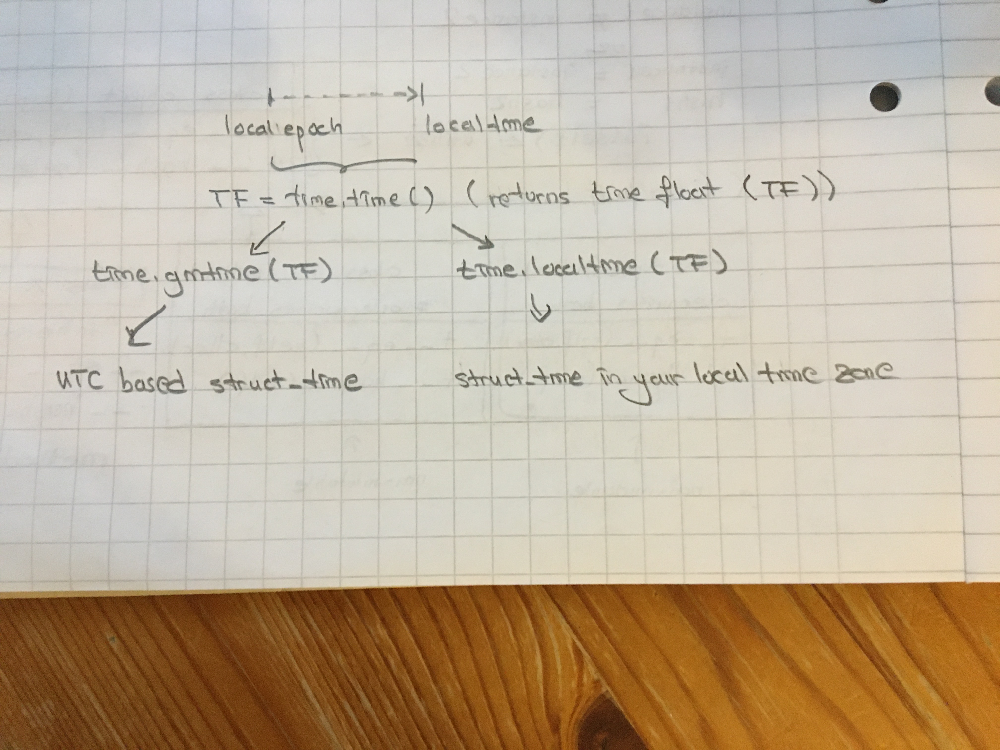

Figure 1 - Converting Time Float to local/UTC struct_time

Here is the code sample:

In [41]:
import time
time_float = time.time()
time_UTC = time.gmtime(time_float)        # UTC time for time_float
time_local = time.localtime(time_float)   # Helsinki time for time_float

print(time_UTC)
print(time_local)

time.struct_time(tm_year=2019, tm_mon=11, tm_mday=13, tm_hour=14, tm_min=35, tm_sec=54, tm_wday=2, tm_yday=317, tm_isdst=0)
time.struct_time(tm_year=2019, tm_mon=11, tm_mday=13, tm_hour=16, tm_min=35, tm_sec=54, tm_wday=2, tm_yday=317, tm_isdst=0)


Note that the only difference is in tm_hour by +2 hours. That is, local time zone is ahead of UTC time zone by 2 hours in a given time float.

**IMPORTANT**: **time.gmtime(time_float)** converts the time float (the number of elapsed seconds since the epoch) to a struct_time in UTC. 

You’ve seen gmtime() used once before in this article:

In [27]:
import time
time.gmtime(0)

time.struct_time(tm_year=1970, tm_mon=1, tm_mday=1, tm_hour=0, tm_min=0, tm_sec=0, tm_wday=3, tm_yday=1, tm_isdst=0)

In this case, you’ve passed 0 as the number of seconds, meaning you’re trying to find the epoch, itself, in UTC.

**NOTE**: The attribute **tm_isdst** is set to 0. This attribute represents whether the time zone is using daylight savings time. **UTC never subscribes to DST**, so that flag will always be 0 when using gmtime()

### time.gmtime(time_float=None) in more detail

The secs parameter for **gmtime()** is optional, meaning you can call **gmtime()** with no arguments. 
Doing so will provide the current time in UTC:

In [11]:
import time
utc_time = time.gmtime()  # current time in UTC
print(utc_time)
print(utc_time.tm_zone)
print(utc_time.tm_gmtoff)

time.struct_time(tm_year=2019, tm_mon=11, tm_mday=14, tm_hour=9, tm_min=32, tm_sec=2, tm_wday=3, tm_yday=318, tm_isdst=0)
GMT
0


As you saw before, struct_time cannot represent fractional seconds, so **gmtime()** ignores the fractional seconds in the argument:

In [31]:
import time
time.gmtime(1.99)

time.struct_time(tm_year=1970, tm_mon=1, tm_mday=1, tm_hour=0, tm_min=0, tm_sec=1, tm_wday=3, tm_yday=1, tm_isdst=0)

Notice that even though the number of seconds you passed was very close to 2, the .99 fractional seconds were simply ignored, as shown by **tm_sec=1**.

### .gmtime(time_float) returns struct_time. Can it be reversed back to time float?

there is no inverse for this function within time. Instead, you’ll have to look in Python’s calendar module for a function named **calendar.timegm():**

In [46]:
import calendar
import time

time_float_original = time.time()            # time float being the same accross all timezones
utc_time = time.gmtime(time_float_original)  # returns the time in UTC for time_float_original
print(utc_time)

time_float_calculated = calendar.timegm(utc_time)  # takes in struct_time named tuple
print(time_float_original)
print(time_float_calculated)

time.struct_time(tm_year=2019, tm_mon=11, tm_mday=13, tm_hour=14, tm_min=52, tm_sec=59, tm_wday=2, tm_yday=317, tm_isdst=0)
1573656779.0679111
1573656779


note that **calendar.timegm()** knows utc_time, it knows that it is in the UTC zone. The difference **utc_time - the epoch** is converted back into time float in seconds.

Now, we can update Figure 1 with the calendar.timegm():

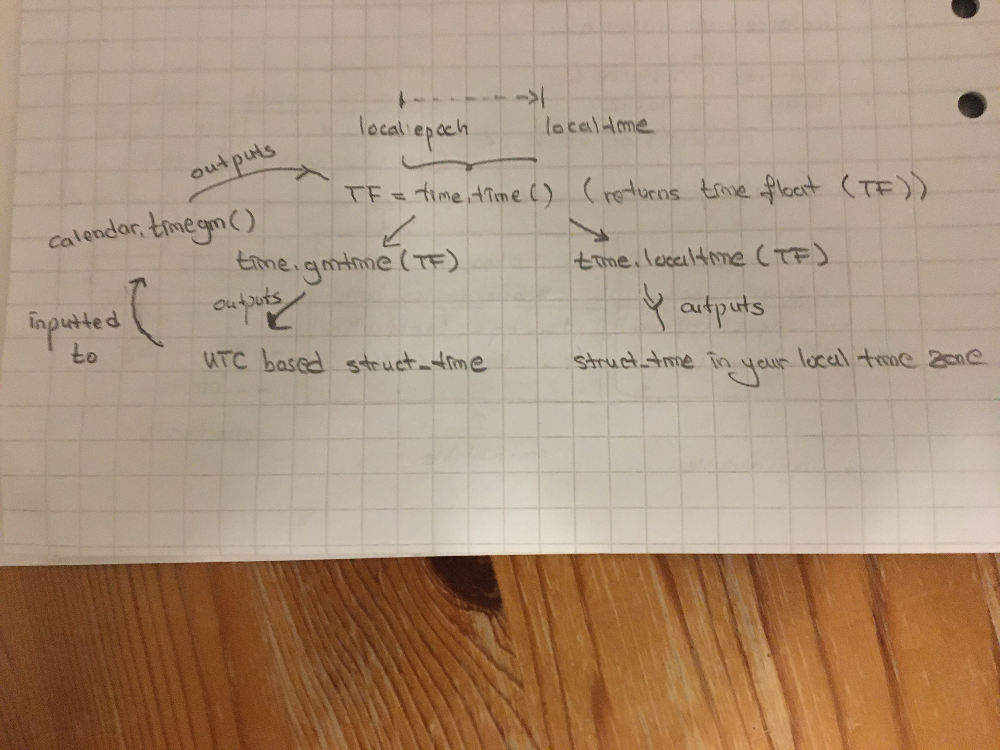

Figure 1 - Converting Time Float to local/UTC struct_time and converting struct_time back to time float

## What is the local time for a given time float (TF)?

As iterated before, use time.localtime(TF) to get the answer. However, it is important to note that
local time zones (anything other than UTC+0) may subscribe to DST in a given moment.

In [14]:
import time
time_float = 60*60*24  # one day after the epoch
a_day_after_epoc_in_local_time = time.localtime(time_float)
print(a_day_after_epoc_in_local_time)
print(a_day_after_epoc_in_local_time.tm_zone)
print(a_day_after_epoc_in_local_time.tm_gmtoff)

time.struct_time(tm_year=1970, tm_mon=1, tm_mday=2, tm_hour=2, tm_min=0, tm_sec=0, tm_wday=4, tm_yday=2, tm_isdst=0)
EET
7200


Like gmtime(), you can ignore the time float argument when calling localtime(), and it will return the current local time in a struct_time:

In [15]:
import time
print(time.localtime())

time.struct_time(tm_year=2019, tm_mon=11, tm_mday=14, tm_hour=11, tm_min=38, tm_sec=13, tm_wday=3, tm_yday=318, tm_isdst=0)


## Converting local struct_time to time float

Unlike **gmtime()**, the inverse function of **localtime()** does exist in the Python time module. Let’s take a look at how that works:

In [25]:
import time

time_float_original = time.time()

local_time_original = time.localtime(time_float_original)  # as struct_time
print(local_time_original, local_time_original.tm_zone, local_time_original.tm_gmtoff)

time_float_calculated = time.mktime(local_time_original)  # Important! mktime() expects local time, not UTC time

local_time_calculated = time.localtime(time_float_calculated)

print(int(time_float_original) == time_float_calculated)  # True
print(local_time_original == local_time_calculated)  # True


time.struct_time(tm_year=2019, tm_mon=11, tm_mday=14, tm_hour=14, tm_min=7, tm_sec=32, tm_wday=3, tm_yday=318, tm_isdst=0) EET 7200
True
True


In the example above, we first get a **time_float_original**. Then calculate the **local_time_original** based on the **time_float_original**. Then we inverse the operation. 

We pass the **local_time_original** to **mktime()** to get the **time_float_calculated**. Then we pass the **time_float_calculated** back to **localtime()** to get the **local_time_calculated**. After that we compare the local_time_original and local_time_calculated. They are the same.


Given the above example, we can update Figure 1 as follows:

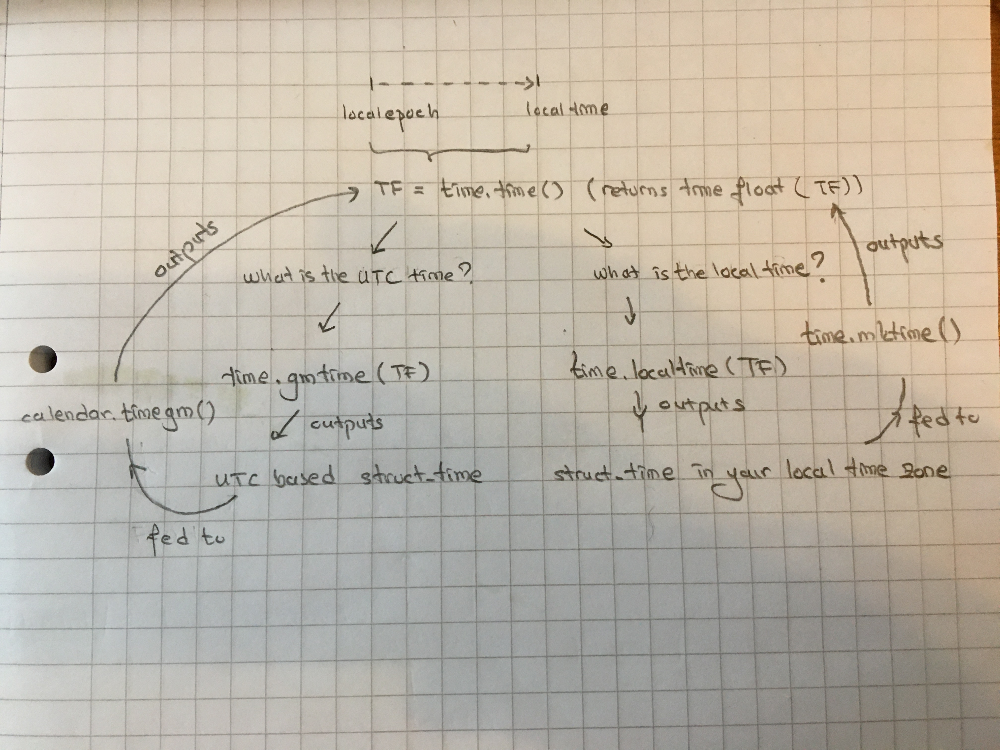

**Figure 1** - Cycling between time float and UTC time, Cycling between time float and local time

**IMPORTANT:** Referring to the picture, calendar.timegm() expects UTC time


**IMPORTANT:** Referring to the picture, time.mktime() expects local time. Refer to [4] to see what error happens if you pass UTC time to time.mktime() utility.

## Converting struct_time to a timestamp

String representations of time, also known as **timestamps**, help make times more readable

There are two Python time functions that you use for converting a **time.struct_time** object to a string:

    asctime()
    strftime()

### time.asctime()

You use asctime() for converting a time tuple or struct_time to a timestamp:

In [29]:
import time
print(time.asctime(time.gmtime()))     # current UTC time timestamp
print(time.asctime(time.localtime()))  # current local time timestamp

Thu Nov 14 12:39:38 2019
Thu Nov 14 14:39:38 2019


**IMPORTANT:** As with ctime(), asctime() also ignores locale information.

If you dont provide a struct_time as input, then the current time as returned by localtime() is used:

In [36]:
import time
print(time.asctime())

Thu Nov 14 15:24:18 2019


### time.strftime() allowing you to format your timestamps

One of the biggest drawbacks of **asctime()** is its format inflexibility. **strftime()** solves this problem by allowing you to format your timestamps.

You may find yourself in a position where the string format from ctime() and asctime() isn’t satisfactory for your application. Instead, you may want to format your strings in a way that’s more meaningful to your users.

One example of this is if you would like to display your time in a string that takes locale information into account.

To format strings, given a struct_time or Python time tuple, you use **strftime()**, which stands for “string format time.”

**strftime()** takes two arguments:

    format specifies the order and form of the time elements in your string
    optional time tuple


To format a string, you use directives. Directives are character sequences that begin with a % that specify a particular time element, such as:

    %d: Day of the month
    %m: Month of the year
    %Y: Year


For example, you can output your local date using the ISO 8601 standard like this:

In [30]:
import time
time.strftime('%Y-%m-%d', time.localtime())

'2019-11-14'

In [35]:
import datetime
datetime.datetime.now().isoformat()

'2019-11-14T15:00:58.262384'

As you saw before, a great benefit of using strftime() over asctime() is its ability to render timestamps that make use of locale-specific information.

For example, if you want to represent the date and time in a locale-sensitive way, you can’t use asctime():

Notice that even after programmatically changing your locale, asctime() still returns the date and time in the same format as before.

When you use **strftime()**, however, you’ll see that it accounts for locale:

**Note**: %c is the directive for locale-appropriate date and time.

If the time tuple is not passed to the parameter t, then strftime() will use the result of localtime() by default:

In [37]:
from time import strftime
strftime('The current local datetime is: %c')

'The current local datetime is: Thu Nov 14 16:03:32 2019'

Here, you’ve used the default time instead of passing your own as an argument. Also, notice that the format argument can consist of text other than formatting directives.

**Further Reading**: Check out this thorough list of directives available to strftime()

### Converting timestamp to a struct_time object

The Python time module also includes the inverse operation of converting **a timestamp back into a struct_time object**.

When you’re working with date and time related strings, it can be very valuable to convert the timestamp to a strcut_time object.

To convert a time string to a struct_time, you use **strptime()** [6], which stands for “string parse time”:

In [43]:
from time import strptime
time_object = strptime('2019-03-01-EET', '%Y-%m-%d-%Z')
print(time_object, time_object.tm_zone, time_object.tm_gmtoff)

time.struct_time(tm_year=2019, tm_mon=3, tm_mday=1, tm_hour=0, tm_min=0, tm_sec=0, tm_wday=4, tm_yday=60, tm_isdst=0) EET None


In the previous examples, tm_isdst=-1. This means that strptime() can’t determine by the timestamp whether it represents daylight savings time or not. tm_zone is determined by %Z directive (EET). 

gmtoff value is None (acc.to [7], there is no directive for it)

The first argument to strptime() must be the timestamp you wish to convert. The second argument is the format that the timestamp is in.

The format parameter is optional and defaults to '%a %b %d %H:%M:%S %Y'

## Suspending Execution via time.sleep()

## Measuring Performance via time.perf_counter() function

The way you do this is to use **time.perf_counter()** which, as the name suggests, provides a performance counter with a high resolution to measure short distances of time.

To use **time.perf_counter()**, you place a counter before your code begins execution as well as after your code’s execution completes:

In [ ]:
>>> from time import perf_counter
>>> def longrunning_function():
...     for i in range(1, 11):
...         time.sleep(i / i ** 2)
...
>>> start = perf_counter()
>>> longrunning_function()
>>> end = perf_counter()
>>> execution_time = (end - start)
>>> execution_time
8.201258441999926

**Note**: Python 3.7 introduced perf_counter_ns(), which works the same as perf_counter(), but uses nanoseconds instead of seconds.

**perf_counter()** (or **perf_counter_ns()**) is the most precise way to measure the performance of your code using one execution. However, if you’re trying to accurately gauge the performance of a code snippet, 
I recommend using the Python **timeit** module.

## Conclusion

Congratulations! You now have a great foundation for working with dates and times in Python.

Now, you’re able to:

    Use a floating point number, representing seconds elapsed since the epoch, to deal with time
    Manage time using tuples and struct_time objects
    Convert between seconds, tuples, and timestamp strings
    Suspend the execution of a Python thread (time.sleep())
    Measure performance using perf_counter()

On top of all that, you’ve learned some fundamental concepts surrounding date and time, such as:

    Epochs
    UTC
    Time zones
    Daylight savings time

## What is next?

The next is to have a look at DateTime module.

## REFERENCES

[1] https://realpython.com/python-time-module/

[2] https://docs.python.org/3/library/time.html#time.ctime

[3] https://stackoverflow.com/questions/13890935/does-pythons-time-time-return-the-local-or-utc-timestamp

[4] https://realpython.com/python-time-module/#converting-a-local-time-object-to-seconds

[5] https://docs.python.org/3/library/time.html#time.asctime

[6] https://docs.python.org/3/library/time.html#time.strptime

[7] https://www.tutorialspoint.com/python/time_strptime.htm